# 图像检索引擎

## 依赖

In [1]:
import ImageRetrievalSystem

### 创建实例

In [2]:
image_retrieval_engine=ImageRetrievalSystem.Engine()

## 加载图片数据

可直接给出目录路径，引擎将自动加载目录下所有png,jpg图片路径,并可以给出加载的图片类型（后缀）

In [18]:
image_retrieval_engine.AddImageByDirectoryPath("images",["jpg","png"])

## 持久化引擎数据
给出保存目录，引擎将自动保存用于查找图片的数据,需要确保目录存在

In [19]:
image_retrieval_engine.Save('data')

保存成功:data/image_paths.txtdata,/image_features.pt


可以从保存目录加载数据，避免重复加载图片（AddImage...）

In [3]:
image_retrieval_engine.Load('data')

加载成功
tensor([[-0.0385, -0.0031,  0.0227,  ...,  0.0650,  0.0035, -0.0947],
        [ 0.0141, -0.0385, -0.0079,  ..., -0.0021,  0.0129,  0.0285],
        [ 0.0133, -0.0067,  0.0073,  ...,  0.0187, -0.0301,  0.0083],
        ...,
        [ 0.0506,  0.0105,  0.0027,  ..., -0.0323, -0.0183, -0.0084],
        [ 0.0276,  0.0137, -0.0057,  ...,  0.0015, -0.0302, -0.0192],
        [ 0.0143, -0.0252, -0.0326,  ...,  0.0941, -0.0009, -0.0046]],
       device='cuda:0', dtype=torch.float16)


## 检索
给出条件，以及返回结果数量
返回结果图片路径列表

### 根据文本检索图片

In [21]:
result_count=5
results=image_retrieval_engine.ImageRetrievalByText("a dog",result_count)

+----------------------+-----------+
|         路径         |   置信度  |
+----------------------+-----------+
| images/000000823.jpg |  27.4375  |
| images/000003213.jpg |   27.375  |
| images/000000179.jpg |  26.59375 |
| images/000000288.jpg | 26.046875 |
| images/000001827.jpg | 25.609375 |
+----------------------+-----------+


可视化结果

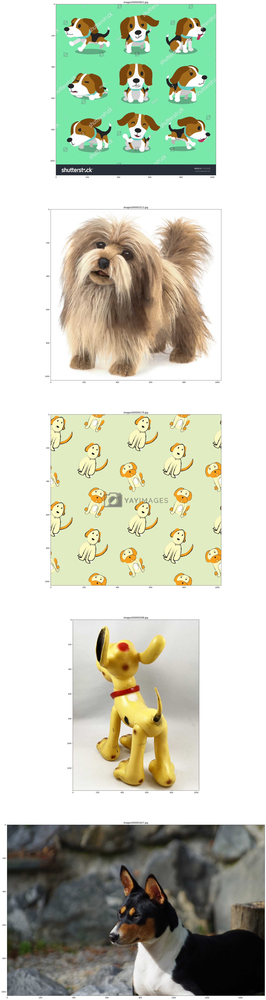

In [22]:
import matplotlib.pyplot as plt
import numpy as np
fig,axs=plt.subplots(result_count,1,figsize=(100,100))
for i in range(result_count):
    axs[i].imshow(plt.imread(results[i]))
    axs[i].set_title(results[i])
    
plt.show()

### 根据图像检索图片

In [4]:
result_count=5
results=image_retrieval_engine.ImageRetrievalByImagePath("test.png",result_count)

+----------------------+---------+
|         路径         |  置信度 |
+----------------------+---------+
| images/000000079.jpg | 83.4375 |
| images/000003098.jpg |  70.625 |
| images/000000103.jpg |  68.75  |
| images/000002283.jpg |   68.0  |
| images/000002357.jpg |   67.5  |
+----------------------+---------+


/home/aihao/miniconda3/envs/torch_stable/lib/python3.11/site-packages/torch/nn/modules/conv.py:459: UserWarning: Applied workaround for CuDNN issue, install nvrtc.so (Triggered internally at /opt/conda/conda-bld/pytorch_1682343995622/work/aten/src/ATen/native/cudnn/Conv_v8.cpp:80.)
  return F.conv2d(input, weight, bias, self.stride,


显示搜索图片

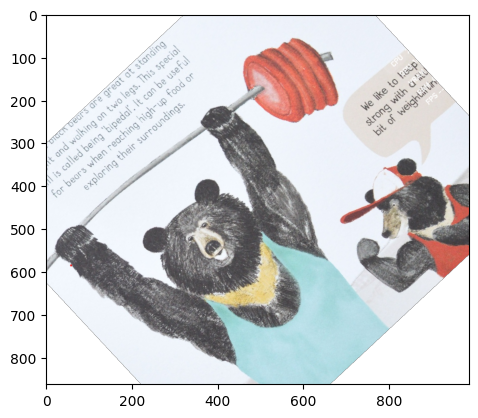

In [6]:
import matplotlib.pyplot as plt
import numpy as np
plt.imshow(plt.imread("test.png"))

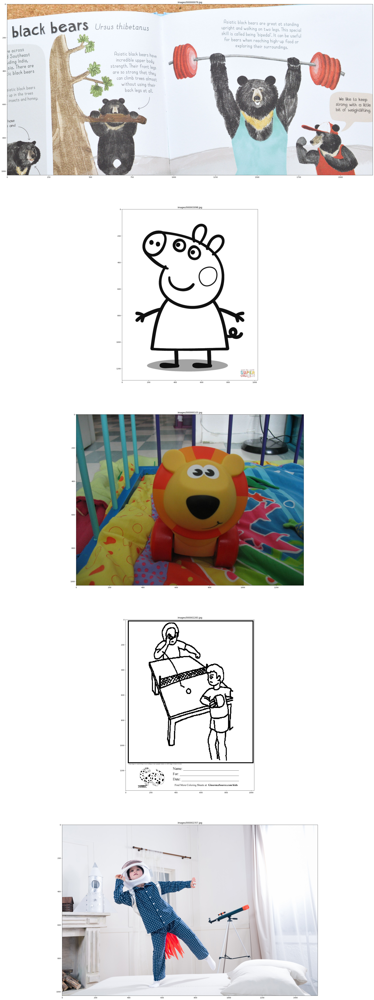

In [8]:

fig,axs=plt.subplots(result_count,1,figsize=(100,100))
for i in range(result_count):
    axs[i].imshow(plt.imread(results[i]))
    axs[i].set_title(results[i])
    
plt.show()